In [1]:
###the problem is that in some cases the line intercepts with more than one subduction iso chron,
#especially in the west pacific

In [2]:
import numpy as np
import pandas as pd
import sys
sys.path.insert(1, '/Users/andrew/Documents/python/pygplates_rev28_python37_MacOS64')
import pygplates
import xarray as xr
import os
from os import walk

import rockhound as rh
from rockhound.slab2 import ZONES
import pygmt
import slab_tracker_utils as slab
import splits_and_merges as snm
import slab_cross_section_utils as sxs
import slab_workflow

import matplotlib.pyplot as plt
import cartopy.crs as ccrs
from matplotlib import cm
from collections import OrderedDict
import cartopy.crs as ccrs
import serpentinite_spreading_grids

from cartopy.mpl.gridliner import LONGITUDE_FORMATTER, LATITUDE_FORMATTER
import matplotlib.ticker as mticker
import matplotlib as mpl
mpl.rcParams['pdf.fonttype'] = 42

from shapely.geometry import Polygon
from shapely.geometry import LineString

#for some reason we get repetitive deprecation warnings, so this mutes them
import warnings
warnings.filterwarnings('ignore', category=DeprecationWarning) 




In [3]:
def get_proper_sections(intersecting_sub_iso_chrons, cross_section):
    
    index_to_remove = []
    for index, i in enumerate(intersecting_sub_iso_chrons):

        intersecting_sub_iso_chron = i[1]

        closest_point_data = \
        pygplates.GeometryOnSphere.distance(cross_section,
                                            intersecting_sub_iso_chron,
                                            return_closest_positions=True,
                                            return_closest_indices=True)
        
        nearest_cross_section_segment = closest_point_data[3]
        nearest_sub_iso_chron_segment = closest_point_data[4]

        cross_section_segment = cross_section.get_segments()[nearest_cross_section_segment]
        cross_section_vector = cross_section_segment.get_arc_direction(0.5)

        sub_iso_chron_segment = intersecting_sub_iso_chron.get_segments()[nearest_sub_iso_chron_segment]
        sub_iso_chron_vector = sub_iso_chron_segment.get_arc_direction(0.5)

        deviation_of_segment_direction_from_cross_section = \
        pygplates.Vector3D.angle_between(cross_section_vector, sub_iso_chron_vector)

        # Change the angle to be between 0 and 90
        deviation_of_segment_direction_from_cross_section_mod = \
        90-np.abs(90-np.remainder(np.degrees(deviation_of_segment_direction_from_stage_pole),\
                                  180))

        #print(i[0], deviation_of_segment_direction_from_cross_section_mod)
        if deviation_of_segment_direction_from_cross_section_mod < 60.0:
            index_to_remove.append(index)
            
    for i in sorted(index_to_remove, reverse=True):
        del intersecting_sub_iso_chrons[i]
        
    return intersecting_sub_iso_chrons

In [4]:
#set directories
platedir = '/Users/andrew/Documents/GitHub/EarthBytePlateMotionModel-ARCHIVE/Muller++_2015_AREPS_CORRECTED/'
savedir = '/Users/andrew/Documents/Data/Merdith_sub_zones/'
datadir = '/Users/andrew/Documents/Data/Merdith_sub_zones/'

#model files
rotfile = '%sGlobal_EarthByte_230-0Ma_GK07_AREPS.rot' % platedir
COBs = '%sAgeGridInput/Global_EarthByte_230-0Ma_GK07_AREPS_COB_Terranes.gpml' % platedir
coastlines = '%sGlobal_EarthByte_230-0Ma_GK07_AREPS_Coastlines.gpml' % platedir
isochrons = '%sAgeGridInput/Global_EarthByte_230-0Ma_GK07_AREPS_Isochrons.gpml' % platedir
input_topology_filename = ['%sGlobal_EarthByte_230-0Ma_GK07_AREPS_PlateBoundaries.gpml' % platedir,
                           '%sGlobal_EarthByte_230-0Ma_GK07_AREPS_Topology_BuildingBlocks.gpml' % platedir]

rotation_model = pygplates.RotationModel(rotfile)

#topologies for our subduction points
time = 0 

resolved_topologies = []
shared_boundary_sections = []

pygplates.resolve_topologies(input_topology_filename, rotation_model,
                             resolved_topologies, int(time), shared_boundary_sections)

#some densities
perid_density_g_cm3 = 3.3 #g/cm3
perid_density_g_km3 = perid_density_g_cm3 * 100000**3
perid_density_kg_km3 = perid_density_g_km3 * 1e-3

In [5]:
cross_section_start_points, sub_length, segments, polarity = slab_workflow.get_sub_parameters(shared_boundary_sections)

Unable to find the overriding and subducting plates of the subducting shared sub-segment "" at 0Ma
    there are not exactly 2 topologies sharing the sub-segment.
911
Unable to find the overriding and subducting plates of the subducting shared sub-segment "" at 0Ma
    there are not exactly 2 topologies sharing the sub-segment.
224
Unable to find the overriding plate of the subducting shared sub-segment "So Melanesian-MG-5-20-07"
    subduction zone feature is missing subduction polarity property or it is set to "Unknown".
Unable to find the overriding plate of the subducting shared sub-segment "So Melanesian-MG-5-20-07"
    subduction zone feature is missing subduction polarity property or it is set to "Unknown".
Unable to find the overriding plate of the subducting shared sub-segment "NAM subduction COB"
    subduction zone feature is missing subduction polarity property or it is set to "Unknown".


In [6]:
forward_distance = 3
back_distance = 1

cross_section_start_points, cross_section_end_points = slab_workflow.make_cross_section(forward_distance, back_distance,
                                                   cross_section_start_points, segments, polarity)

#have to convert our longitude points to 0–360 to accommodate rockhound (i think, super annoying)
for ind,i in enumerate(cross_section_end_points[:,1]):
    if i < 0:
        cross_section_end_points[ind][1] = i+360
for ind,i in enumerate(cross_section_start_points[:,1]):
    if i < 0:
        cross_section_start_points[ind][1] = i+360        

Left
Left
Left
Left
Left
Left
Left
Left
Left
Left
Left
Left
Left
Left
Left
Left
Left
Right
17
Right
18
Right
19
Right
20
Right
21
Right
22
Right
23
Right
24
Right
25
Right
26
Right
27
Right
28
Right
29
Right
30
Right
31
Right
32
Right
33
Right
34
Right
35
Left
Left
Left
Left
Left
Left
Left
Left
Left
Left
Left
Left
Left
Left
Left
Left
Left
Left
Left
Left
Left
Right
57
Right
58
Right
59
Right
60
Right
61
Right
62
Right
63
Right
64
Right
65
Right
66
Right
67
Right
68
Right
69
Right
70
Right
71
Right
72
Right
73
Right
74
Right
75
Right
76
Right
77
Right
78
Right
79
Right
80
Right
81
Right
82
Right
83
Right
84
Right
85
Left
Left
Left
Left
Left
Left
Left
Left
Right
94
Right
95
Right
96
Right
97
Right
98
Right
99
Right
100
Right
101
Right
102
Right
103
Right
104
Right
105
Right
106
Right
107
Right
108
Right
109
Right
110
Right
111
Left
Left
Left
Left
Left
Left
Left
Left
Left
Left
Left
Left
Left
Left
Left
Left
Left
Left
Left
Left
Left
Left
Left
Left
Left
Left
Left
Left
Left
Left
Left
Left
Left

In [7]:
#load our other data needed to populate the cross section
#open slab2 geometry (made in in Slab2_geometry_Py3 notebook)
ds_in = xr.open_dataset('%sSlab2point0/sub_zones_Slab2.nc' % datadir)
#organise our dataarray so its stacked
ds_stacked = ds_in.stack(x=['latitude','longitude'])


#peridotite grid
grid_filename = ['/Users/andrew/Documents/Data/Chapman_arc_flare_up_DATA/thickness_grids/peridotite_thickness_post_serpentinisation','_Ma.nc',
                 '/Users/andrew/Documents/Data/plate_model_grids/Muller_etal_2016_AREPS_Agegrids_v1.17/Muller_etal_2016_AREPS_v1.17_netCDF/Muller_etal_2016_AREPS_v1.17_AgeGrid-','.nc']
output_data = slab_workflow.get_subducted_slabs(5., 0., 1.0, 
                                                grid_filename, 
                                                ds_stacked)

#close datasets as we no longer need them
#del ds_in
#del ds_stacked



plates that persist between 6.00 Ma and 5.00 Ma are: 
 {645, 646, 901, 904, 903, 909, 653, 911, 659, 406, 664, 669, 801, 802, 676, 677, 678, 301, 686, 815, 818, 821, 566, 824, 701, 829, 709, 328, 969, 970, 201, 334, 849, 337, 340, 607, 224, 608, 101, 501, 503, 511}

plates that appeared between 6.00 Ma and 5.00 Ma are: 
 {564, 699}

plates that disappeared between 6.00 Ma and 5.00 Ma are: 
 {819, 972}

Working on appearing plates
Centroid for plate 564 mapped to plate 678 at delta time
Centroid for plate 699 mapped to plate 659 at delta time

Working on disappearing plates
Centroid for plate 819 mapped to plate 818 at delta time
Centroid for plate 972 mapped to plate 911 at delta time
[(819, 818), (972, 911)]
here (819, 972)
plates that persist between 5.00 Ma and 4.00 Ma are: 
 {645, 646, 901, 904, 903, 909, 653, 911, 659, 406, 664, 669, 801, 802, 676, 677, 678, 301, 686, 815, 818, 821, 566, 824, 699, 701, 829, 709, 328, 201, 970, 969, 334, 337, 849, 340, 607, 224, 608, 101, 501, 503,

Unable to find the overriding plate of the subducting shared sub-segment "Woodlark MOR"
    subduction zone feature is missing subduction polarity property or it is set to "Unknown".
Unable to find the overriding plate of the subducting shared sub-segment "NAM subduction COB"
    subduction zone feature is missing subduction polarity property or it is set to "Unknown".


Using 4.00 to 3.00 Ma stage pole for plate 904
Using 4.00 to 3.00 Ma stage pole for plate 904
Using 4.00 to 3.00 Ma stage pole for plate 904
Using 4.00 to 3.00 Ma stage pole for plate 904
time 4.00 Ma
Using 4.00 to 3.00 Ma stage pole for plate 904
Using 4.00 to 3.00 Ma stage pole for plate 904
Using 4.00 to 3.00 Ma stage pole for plate 904
Using 4.00 to 3.00 Ma stage pole for plate 904


Unable to find the overriding plate of the subducting shared sub-segment "Woodlark MOR"
    subduction zone feature is missing subduction polarity property or it is set to "Unknown".
Unable to find the overriding plate of the subducting shared sub-segment "NAM subduction COB"
    subduction zone feature is missing subduction polarity property or it is set to "Unknown".


Using 4.00 to 3.00 Ma stage pole for plate 904
Using 4.00 to 3.00 Ma stage pole for plate 904
Using 4.00 to 3.00 Ma stage pole for plate 904
Using 4.00 to 3.00 Ma stage pole for plate 904
time 3.00 Ma


Unable to find the overriding plate of the subducting shared sub-segment "Woodlark MOR"
    subduction zone feature is missing subduction polarity property or it is set to "Unknown".
Unable to find the overriding plate of the subducting shared sub-segment "" at 3.0Ma
    both sharing topologies are on subducting side of subducting line.
Unable to find the overriding plate of the subducting shared sub-segment "NAM subduction COB"
    subduction zone feature is missing subduction polarity property or it is set to "Unknown".


time 2.00 Ma


Unable to find the overriding plate of the subducting shared sub-segment "Woodlark MOR"
    subduction zone feature is missing subduction polarity property or it is set to "Unknown".
Unable to find the overriding plate of the subducting shared sub-segment "" at 2.0Ma
    both sharing topologies are on subducting side of subducting line.
Unable to find the overriding plate of the subducting shared sub-segment "NAM subduction COB"
    subduction zone feature is missing subduction polarity property or it is set to "Unknown".


time 1.00 Ma


Unable to find the overriding plate of the subducting shared sub-segment "" at 1.0Ma
    both sharing topologies are on subducting side of subducting line.
Unable to find the overriding plate of the subducting shared sub-segment "So Melanesian-MG-5-20-07"
    subduction zone feature is missing subduction polarity property or it is set to "Unknown".
Unable to find the overriding plate of the subducting shared sub-segment "So Melanesian-MG-5-20-07"
    subduction zone feature is missing subduction polarity property or it is set to "Unknown".
Unable to find the overriding plate of the subducting shared sub-segment "NAM subduction COB"
    subduction zone feature is missing subduction polarity property or it is set to "Unknown".
Unable to find the overriding and subducting plates of the subducting shared sub-segment "NAM subduction COB clone" at 1.0Ma
    there are not exactly 2 topologies sharing the sub-segment.
101
Unable to find the overriding and subducting plates of the subducting sh

time 0.00 Ma


Unable to find the overriding and subducting plates of the subducting shared sub-segment "" at 0.0Ma
    there are not exactly 2 topologies sharing the sub-segment.
224
Unable to find the overriding and subducting plates of the subducting shared sub-segment "" at 0.0Ma
    there are not exactly 2 topologies sharing the sub-segment.
911
Unable to find the overriding plate of the subducting shared sub-segment "So Melanesian-MG-5-20-07"
    subduction zone feature is missing subduction polarity property or it is set to "Unknown".
Unable to find the overriding plate of the subducting shared sub-segment "So Melanesian-MG-5-20-07"
    subduction zone feature is missing subduction polarity property or it is set to "Unknown".
Unable to find the overriding plate of the subducting shared sub-segment "NAM subduction COB"
    subduction zone feature is missing subduction polarity property or it is set to "Unknown".


In [8]:
def populate_cross_section(output_data, cross_section_end_points,
                       cross_section_start_points, steps):

    '''
    given a lat-lon point and two distances, constructs a cross section between the start
    and end points through the lat-lon point for pygmt and rockhunter

    Inputs
    _______
    output_data: array
        series of arrays describing a subducted slab

    cross_section_start_points and cross_section_end_points: array
        input lat/lons that define the start/end pooints of our cross-sections

    steps: int
        number of steps in the cross section

    Returns
    ________
    cross_section_points: dataframe
        pandas dataframe of longitude and latitude (USED FOR PYGMT)
    cross_section_lines: array
        array of latitude and longitude points defining a cross-section
    intersecting_lines: array
        array of lines from a sub-isochron from a subducted slab that intersect
        with our cross section (this is where our data is stored)
    '''

    cross_section_end_point = cross_section_end_points[:]
    cross_section_start_point = cross_section_start_points[:]
    #define line for cross section
    #we need two types of cross sections, one for slab 2.0
    #one for pygmt
    #they, unfortunately, have to be built in different ways

    #slab2.0
    cross_section_points = []
    cross_section_lines = []
    intersecting_lines = []
    distance_to_lines = []
    sorted_intersecting_lines = []
    for ind, (end_point, start_point) in enumerate(zip(cross_section_end_point, cross_section_start_point)):
        start_lat = start_point[0]
        start_lon = start_point[1]
        end_lat = end_point[0]
        end_lon = end_point[1]

        #get cross_section line
        cross_section_line = slab_workflow.cross_section_line_pygplates(start_lat,
                                                          start_lon,
                                                          end_lat,
                                                          end_lon,
                                                          0.1)

        #get the iso-subchrons that intersect the cross section line

        intersecting_line = []
        distance_to_line = []
        #NB this returns the lines in a non-random, but non correct order
        for ind1, polyline in enumerate(output_data):
            #print(ind)
            #if not polyline:
            #    continue
            #get min distance between 'iso-sub-chron' and our cross section
            min_distance_to_feature = pygplates.GeometryOnSphere.distance(polyline[1], cross_section_line)
            #if min distance is 0, then they intersect and we want the rest of the data

            if min_distance_to_feature == 0:
                intersecting_line.append(polyline)
                distance_to_line.append(pygplates.GeometryOnSphere.distance(polyline[1],
                                                                pygplates.PointOnSphere([start_lat,
                                                                    start_lon])))
        #print(distance_to_line)
        #now we can order (sort) our lines correctly based on distance to start of cross_section
        sorted_lines = [x for _,x in sorted(zip(distance_to_line,intersecting_line))]
        
        new_intersecting_lines = []
        #already sorted based on distance to present-day subduction zone
        #so the last entry is the '0' Ma
        if sorted_lines:
            #print(len(sorted_lines))
            tmp_overriding_plate = sorted_lines[-1][-2]
            tmp_downgoing_plate = sorted_lines[-1][-1]
            for sorted_line in sorted_lines:
                if sorted_line[-1] == tmp_downgoing_plate:
                    #print(line[0])
                    new_intersecting_lines.append(sorted_line)
        print(ind, len(sorted_lines), len(new_intersecting_lines))
        steps = 200
        lat = np.linspace(start_lat,end_lat, int(steps))
        lon = np.linspace(start_lon,end_lon, int(steps))

        #pygmt track needs lon/lat as separate columns in pandas dataframe
        d = { 'lon': lon,'lat': lat}
        points = pd.DataFrame(data=d)

        cross_section_points.append(points)
        cross_section_lines.append(cross_section_line)
        intersecting_lines.append(intersecting_line)
        sorted_intersecting_lines.append(new_intersecting_lines)
        #sorted_intersecting_lines.append(sorted_lines)
        distance_to_lines.append(distance_to_line)
    return cross_section_points, cross_section_lines, sorted_intersecting_lines

In [9]:
#get cross section points

steps = 200
cross_section_points, cross_section_lines, intersecting_lines = populate_cross_section(output_data,
                                                                                     cross_section_end_points, 
                       cross_section_start_points, steps)

0 6 6
1 6 6
2 5 5
3 6 6
4 6 6
5 6 6
6 7 1
7 6 6
8 6 6
9 6 6
10 4 3
11 8 5
12 10 5
13 6 6
14 6 6
15 6 6
16 6 6
17 6 6
18 6 6
19 6 6
20 6 6
21 6 6
22 6 6
23 6 6
24 6 6
25 6 6
26 6 6
27 6 6
28 6 6
29 6 6
30 0 0
31 6 6
32 6 6
33 6 6
34 12 6
35 9 6
36 9 9
37 8 8
38 4 4
39 4 4
40 4 4
41 4 4
42 4 4
43 4 4
44 4 4
45 6 6
46 6 6
47 6 6
48 6 6
49 6 6
50 6 6
51 6 6
52 6 6
53 6 6
54 6 6
55 6 6
56 6 6
57 6 6
58 6 6
59 5 5
60 5 5
61 5 2
62 6 3
63 7 3
64 8 5
65 6 6
66 5 5
67 4 4
68 4 4
69 5 5
70 4 4
71 4 4
72 4 4
73 2 2
74 3 3
75 3 3
76 3 3
77 3 3
78 3 3
79 3 3
80 4 4
81 5 5
82 6 6
83 6 6
84 6 6
85 6 6
86 4 3
87 7 5
88 5 5
89 6 5
90 5 5
91 6 5
92 7 5
93 7 5
94 6 6
95 6 6
96 10 7
97 1 1
98 1 1
99 2 2
100 2 2
101 2 2
102 4 4
103 6 6
104 5 1
105 4 3
106 7 5
107 8 6
108 7 6
109 6 6
110 6 6
111 6 6
112 7 4
113 6 6
114 6 6
115 6 6
116 6 6
117 6 6
118 6 6
119 6 6
120 6 6
121 6 6
122 10 6
123 7 6
124 6 5
125 6 5
126 6 1
127 8 2
128 7 7
129 7 7
130 6 6
131 6 6
132 6 6
133 6 6
134 6 6
135 6 6
136 5 5
137 11 5
1

In [10]:
####
#all sections
# Fetch all Slab2 subduction zones and add them inside a list
subduction_zones = []
for zone in ZONES:
    subduction_zones.append(rh.fetch_slab2(zone))
    
#merge into global
#global_sub_zones = xr.merge([grid for grid in subduction_zones])



In [11]:
def check_constant_length(intersecting_sub_iso_chrons):

    valid_sub_iso_chrons = []
    example_length = intersecting_sub_iso_chrons[-1][1].get_arc_length()
    for index, intersecting_sub_iso_chron in enumerate(intersecting_sub_iso_chrons):
        #print(intersecting_sub_iso_chron[1].get_arc_length())
        if example_length*0.5 < intersecting_sub_iso_chron[1].get_arc_length() < example_length*1.5:
            valid_sub_iso_chrons.append(intersecting_sub_iso_chron)
            
    return valid_sub_iso_chrons

/Users/andrew/miniconda3/envs/py377/lib/python3.7/site-packages/ipykernel_launcher.py:61: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


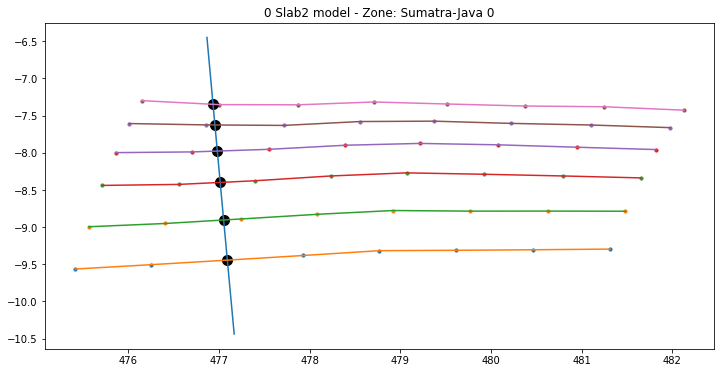

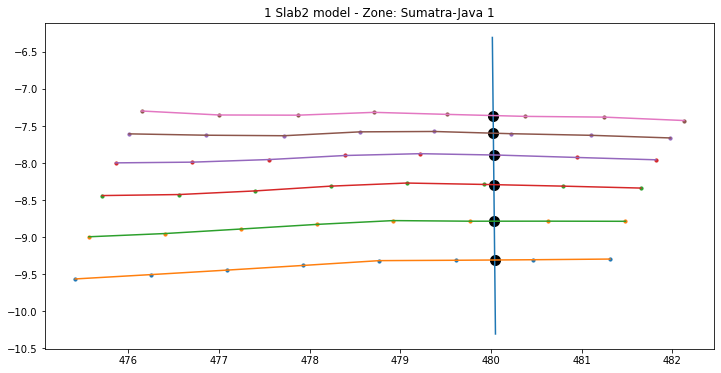

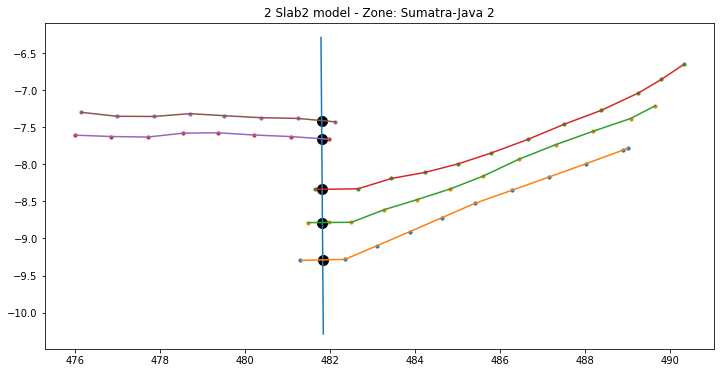

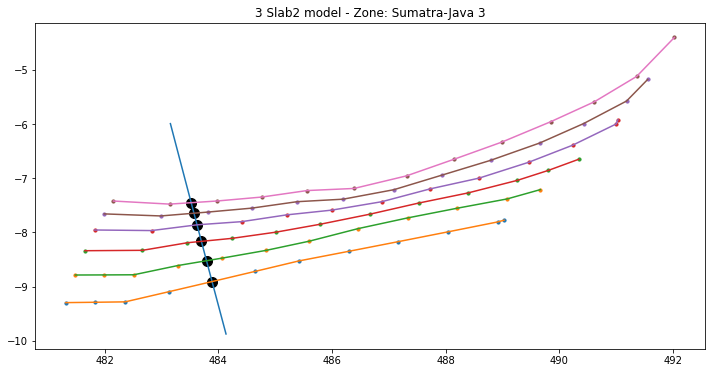

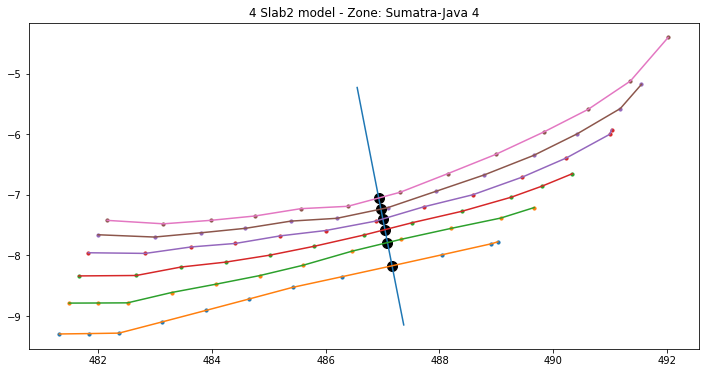

...

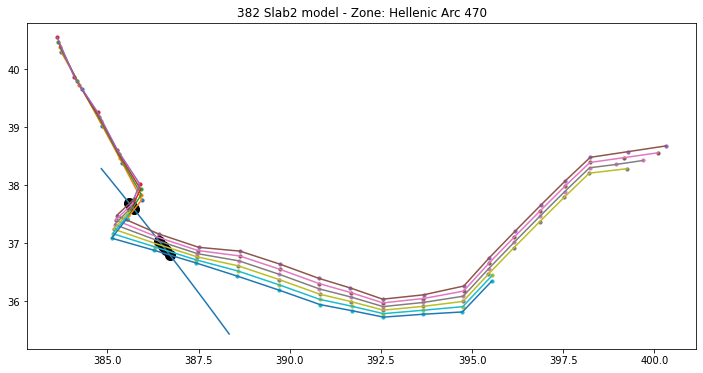

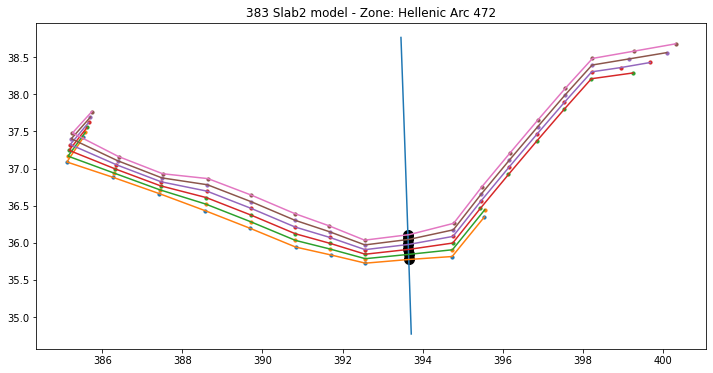

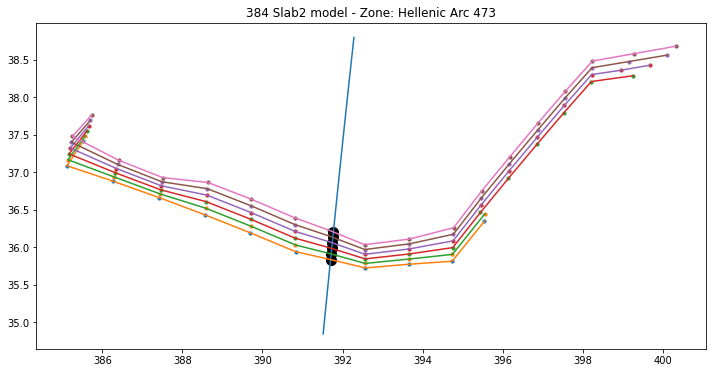

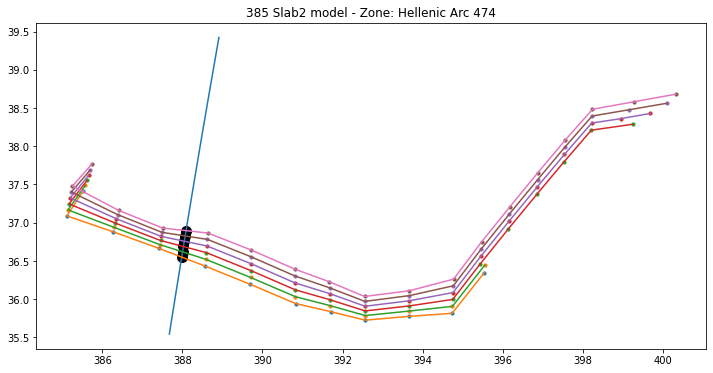

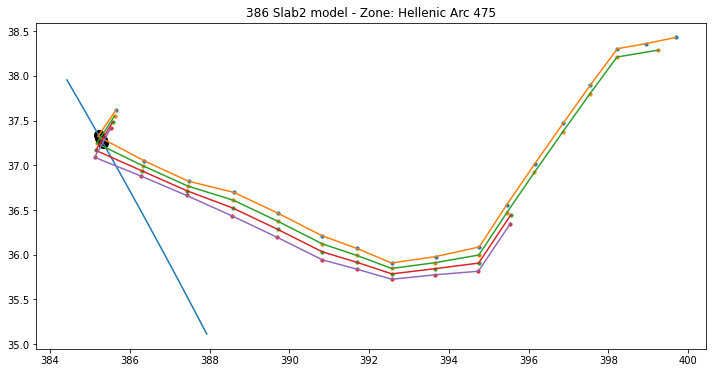

In [12]:
#here we loop through all our extracted data to get the relevant bits
age_variable = [] #age
perid_variable = [] #peridotite
intersecting_points = []
intersecting_depths = []
intersecting_cross_sections_index = []
nan_cross_section = []
sub_zone_names = []
new_sub_length = []
tracks = []

#loop through points
count = 0
for ind, points in enumerate(cross_section_points[:]):
    #print(ind)
    #loop through sub zones to find the closest
    for sub_ind, sub_zone in enumerate(subduction_zones):
        #print(ind, sub_zone.title)
        
        #get depth parameters of sub_zone
        grid = sub_zone.depth
        
        
        ###main calculation, get data from cross sections

        #Sample the sub zone using grdtrack. It returns a dataframe with a new column and the results
        track = pygmt.grdtrack(points=points, grid=grid, newcolname='depth')#, Verbose=False)
        #print(ind)
        #print(track)
        #if our track is empty or has value of 0 we can skip
        if len(track.index) == 0:
            #tracks.append(np.nan)#print('null', ind)
            #if sub_ind+1 == len(subduction_zones):
              #  print('here')
            #    tracks.append([0])
            #    intersecting_points.append([0])
             #   intersecting_depths.append([0])
            continue

        if np.sum(track.depth) == 0.0:
            #tracks.append(np.nan)
            #print('null', ind)
#            if sub_ind+1 == len(subduction_zones):
#                print('here2')
#                tracks.append([0])
            continue
        #no intersection at all
        if np.nanmin(track.depth * -0.001) > 100.0:
            #print('here')
            continue
        
        #but here we have data (i.e. we found what slab our cross section intersected)
        else:
            #print(ind, sub_zone.title)
            #print(track)
            #now we can get the uncertainty
            grid_uncertainty = sub_zone.depth_uncertainty
            
            track_uncertain = pygmt.grdtrack(points=points, grid=grid_uncertainty, 
                                             newcolname='depth_uncertainty')#, Verbose=False)
            plt.figure(figsize=(12,6))
            #plt.plot(points['lon'].values, points['lat'].values, c='k', alpha=0.5)
            #plt.scatter(points['lon'].values, points['lat'].values, c='k', s=1)
            
            plt.plot(cross_section_lines[ind].to_lat_lon_array()[:,1]+360,
                     cross_section_lines[ind].to_lat_lon_array()[:,0])
            for i in intersecting_lines[ind]:
                #print(i[1])
                plt.plot((i[1].to_lat_lon_array()[:,1]+360),
                         i[1].to_lat_lon_array()[:,0])
                plt.scatter((i[1].to_lat_lon_array()[:,1]+360),
                             i[1].to_lat_lon_array()[:,0], s=10)
            
            
            #the df will contain some NaNs that we want to filter
            track_dropna = track.dropna()
            #we then have to make a copy because i dont quite understand pandas indexing?
            track_dropna_copy = track_dropna.copy()
            
            #sane for depth uncertainty
            track_uncertain_dropna = track_uncertain.dropna()
            track_uncertain_dropna_copy = track_uncertain_dropna.copy()
            
            #our data so far is in - m, lets convert to (positive) km
            track_dropna_copy.loc[:,'depth'] = track_dropna.loc[:,'depth'] * -0.001
            track_uncertain_dropna_copy.loc[:,'depth_uncertainty'] = track_uncertain_dropna.loc[:,'depth_uncertainty'] * 0.001
            
           

            #get points intersecting the cross section
            intersecting_points_reversed, intersecting_points_normal, interpolated_variables, interpolated_depths = slab_workflow.get_intersecting_values(intersecting_lines[ind],
                                                                        cross_section_lines[ind])
            
            for i in intersecting_points_reversed:
                plt.scatter((i[1].to_lat_lon_array()[:,1]+360),
                         i[1].to_lat_lon_array()[:,0], c='k',s=100)
                
            plt.title(str(count) + ' ' + str(sub_zone.title) + ' ' + str(ind))
            #print(ind, sub_zone.title)
            perid_variable.append(interpolated_variables[::2])
            age_variable.append(interpolated_variables[1::2])

            intersecting_points.append(intersecting_points_normal)
            intersecting_depths.append(interpolated_depths)
            intersecting_cross_sections_index.append(ind)
            

            
            sub_zone_names.append(sub_zone.title)
            new_sub_length.append(sub_length[ind])
            track_dropna_copy['depth_uncertainty'] = track_uncertain_dropna_copy['depth_uncertainty']
            tracks.append(track_dropna_copy)
            count += 1
            break
            
del grid
del grid_uncertainty
for zone in subduction_zones:
    del zone

/Users/andrew/miniconda3/envs/py377/lib/python3.7/site-packages/ipykernel_launcher.py:59: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


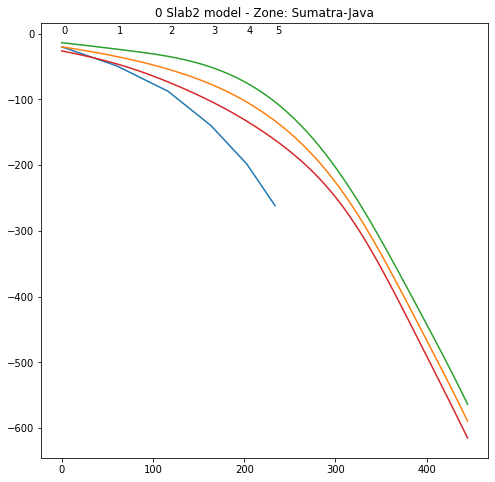

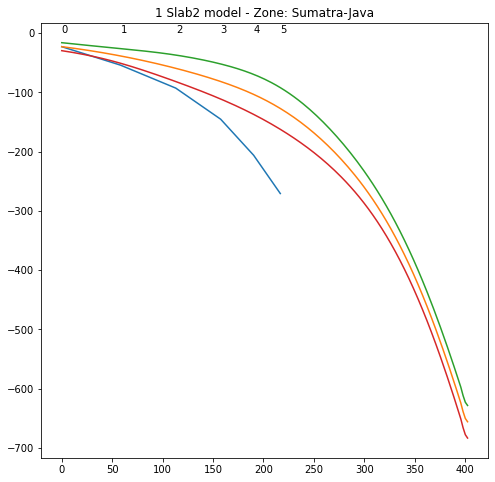

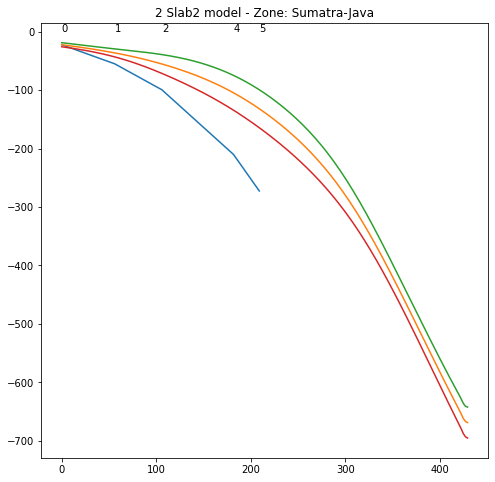

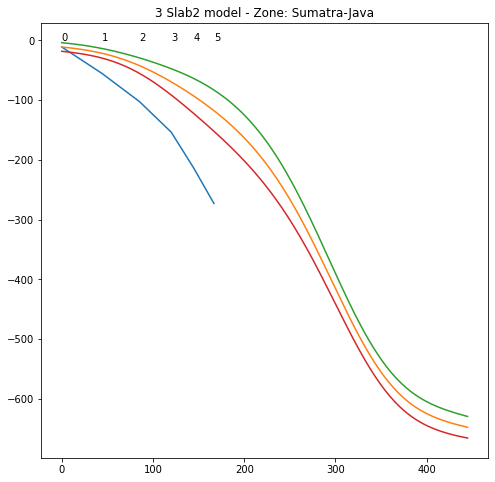

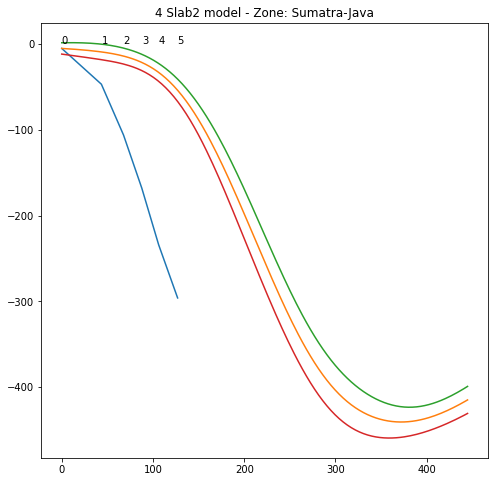

...

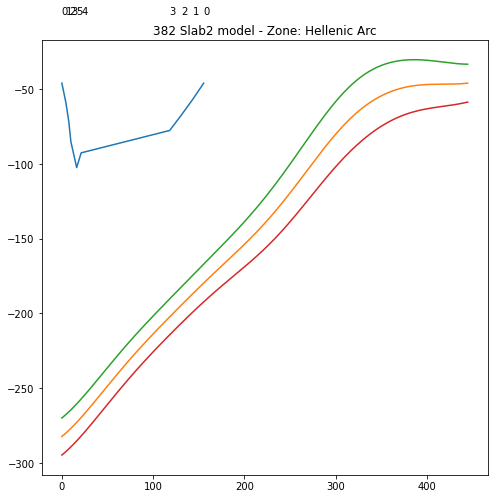

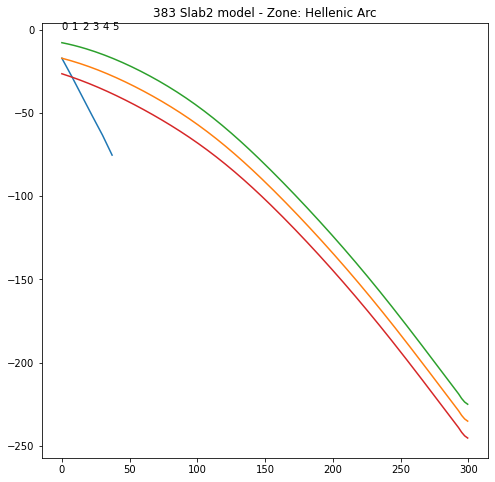

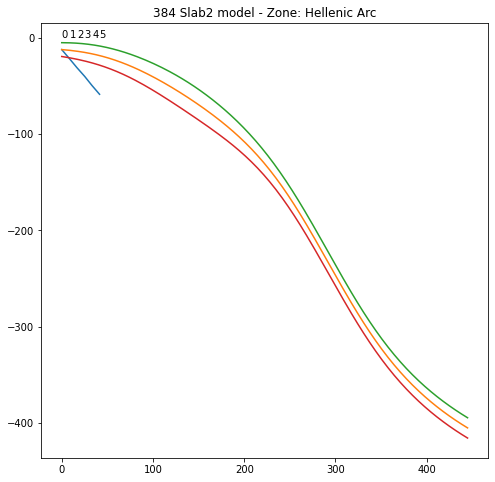

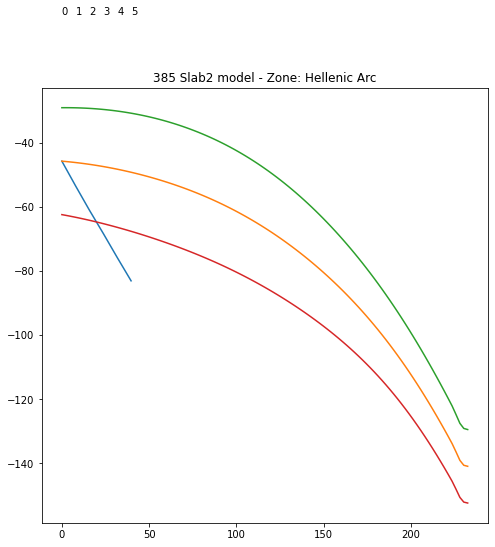

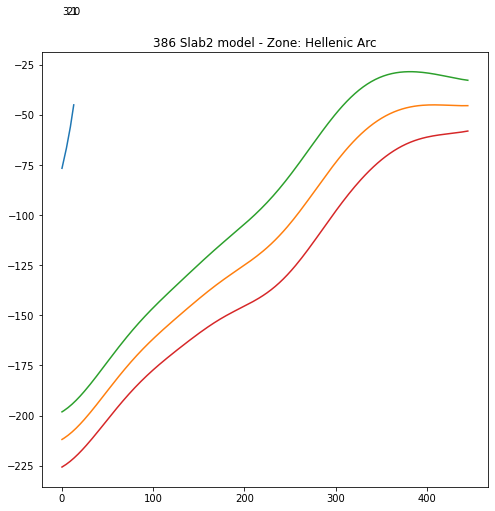

In [13]:
for tracks_ind,i in enumerate(tracks):
    #print(tracks_ind)
    temp_distances_tracks = []
    for ind, (row_ind, row) in enumerate(tracks[tracks_ind].iterrows()):
        #print(ind)
        if ind == 0:
            #print(ind)
            temp_distances_tracks.append(0)            
        else:
            #print('h',ind)
            #print(tracks[-100]['lon'].values[ind-1])
            lon1 = tracks[tracks_ind]['lon'].values[ind-1]
            lat1 = tracks[tracks_ind]['lat'].values[ind-1]
            lon2 = row['lon']
            lat2 = row['lat']

            lon1, lat1, lon2, lat2 = map(np.radians, [lon1, lat1, lon2, lat2])
            dlon = lon2 - lon1
            dlat = lat2 - lat1 

            a = np.sin(dlat/2)**2 + np.cos(lat1) * np.cos(lat2) * np.sin(dlon/2)**2

            c = 2 * np.arcsin(np.sqrt(a)) 
            r = 6371 # Radius of earth in kilometers. Use 3956 for miles

            distance = c*r
            temp_distances_tracks.append(distance + temp_distances_tracks[ind-1])
    #temp_distances.reverse()
    temp_lats = []
    temp_lons = []
    temp_distances = []
    SUBCHRONS = []
    for ind, i in enumerate(intersecting_points[tracks_ind]):
         #technically ind-1 for ind=0 is the same as the last index (i.e. tracks_ind[-1])
         #however, as this only occurs at index=0, we cover our base in lines 53-55
        lon1 = intersecting_points[tracks_ind][ind-1][1].to_lat_lon_array()[0][1]
        lat1 = intersecting_points[tracks_ind][ind-1][1].to_lat_lon_array()[0][0]
        lon2 = intersecting_points[tracks_ind][ind][1].to_lat_lon_array()[0][1]
        lat2 = intersecting_points[tracks_ind][ind][1].to_lat_lon_array()[0][0]
        SUBCHRON = int(intersecting_points[tracks_ind][ind][0])
        lon1, lat1, lon2, lat2 = map(np.radians, [lon1, lat1, lon2, lat2])
        dlon = lon2 - lon1
        dlat = lat2 - lat1 

        a = np.sin(dlat/2)**2 + np.cos(lat1) * np.cos(lat2) * np.sin(dlon/2)**2

        c = 2 * np.arcsin(np.sqrt(a)) 
        r = 6371 # Radius of earth in kilometers. Use 3956 for miles
        distance = c*r
        SUBCHRONS.append(SUBCHRON)
        temp_lats.append(lat1)
        temp_lons.append(lon1) 
        if ind == 0:
            temp_distances.append(0)
        else:
            temp_distances.append(distance + temp_distances[ind-1])

    #temp_distances.reverse()
    fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(8,8))
    ax.plot(temp_distances, [i*-1-tracks[tracks_ind]['depth'].min() for i in intersecting_depths[tracks_ind]])
    ax.plot(temp_distances_tracks,tracks[tracks_ind]['depth']*-1)
    ax.plot(temp_distances_tracks,tracks[tracks_ind]['depth']*-1+tracks[tracks_ind]['depth_uncertainty'])
    ax.plot(temp_distances_tracks,tracks[tracks_ind]['depth']*-1-tracks[tracks_ind]['depth_uncertainty'])
    for i in range(len(SUBCHRONS)):
        ax.text(temp_distances[i],0, SUBCHRONS[i])
    ax.set_title(str(tracks_ind) + ' ' + str(sub_zone_names[tracks_ind]))

In [14]:
tracks_ind=13
test_index=13
temp_distances_tracks = []
for ind, (row_ind, row) in enumerate(tracks[tracks_ind].iterrows()):
    #print(ind)
    if ind == 0:
        #print(ind)
        temp_distances_tracks.append(0)
    else:
        #print('h',ind)
        #print(tracks[-100]['lon'].values[ind-1])
        lon1 = tracks[tracks_ind]['lon'].values[ind-1]
        lat1 = tracks[tracks_ind]['lat'].values[ind-1]
        lon2 = row['lon']
        lat2 = row['lat']

        lon1, lat1, lon2, lat2 = map(np.radians, [lon1, lat1, lon2, lat2])
        dlon = lon2 - lon1
        dlat = lat2 - lat1 

        a = np.sin(dlat/2)**2 + np.cos(lat1) * np.cos(lat2) * np.sin(dlon/2)**2

        c = 2 * np.arcsin(np.sqrt(a)) 
        r = 6371 # Radius of earth in kilometers. Use 3956 for miles

        distance = c*r
        temp_distances_tracks.append(distance + temp_distances_tracks[ind-1])
temp_lats = []
temp_lons = []
temp_distances = []
SUBCHRONS = []
for ind, i in enumerate(intersecting_points[tracks_ind]):
     #print('h',ind)
    lon1 = intersecting_points[tracks_ind][ind-1][1].to_lat_lon_array()[0][1]
    lat1 = intersecting_points[tracks_ind][ind-1][1].to_lat_lon_array()[0][0]
    lon2 = intersecting_points[tracks_ind][ind][1].to_lat_lon_array()[0][1]
    lat2 = intersecting_points[tracks_ind][ind][1].to_lat_lon_array()[0][0]
    SUBCHRON = int(intersecting_points[tracks_ind][ind][0])
    lon1, lat1, lon2, lat2 = map(np.radians, [lon1, lat1, lon2, lat2])
    dlon = lon2 - lon1
    dlat = lat2 - lat1 

    a = np.sin(dlat/2)**2 + np.cos(lat1) * np.cos(lat2) * np.sin(dlon/2)**2

    c = 2 * np.arcsin(np.sqrt(a)) 
    r = 6371 # Radius of earth in kilometers. Use 3956 for miles
    distance = c*r
    SUBCHRONS.append(SUBCHRON)
    temp_lats.append(lat1)
    temp_lons.append(lon1) 
    if ind == 0:
        temp_distances.append(0)
    else:
        temp_distances.append(distance + temp_distances[ind-1])

#temp_distances.reverse()


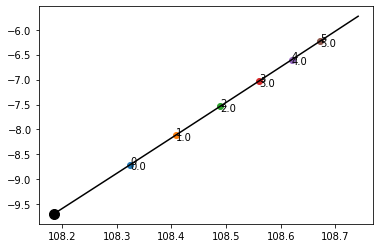

In [15]:
for ind, i in enumerate(intersecting_points[tracks_ind]):
#    print(i[1])
    plt.scatter(i[1].to_lat_lon_array()[:,1],
                i[1].to_lat_lon_array()[:,0])
    plt.text(i[1].to_lat_lon_array()[:,1],
             i[1].to_lat_lon_array()[:,0],
             ind)
    plt.text(i[1].to_lat_lon_array()[:,1],
             i[1].to_lat_lon_array()[:,0]-0.1,
             i[0])
    
plt.plot(cross_section_lines[intersecting_cross_sections_index[tracks_ind]].to_lat_lon_array()[:,1],
         cross_section_lines[intersecting_cross_sections_index[tracks_ind]].to_lat_lon_array()[:,0], c='k')
plt.scatter(cross_section_lines[intersecting_cross_sections_index[tracks_ind]].to_lat_lon_array()[:,1][0],
            cross_section_lines[intersecting_cross_sections_index[tracks_ind]].to_lat_lon_array()[:,0][0], c='k', s=100)


In [16]:
temp_distances

[0,
 67.03792378879818,
 131.06955253325333,
 188.76418947175705,
 236.4242831716079,
 277.51025817004086]

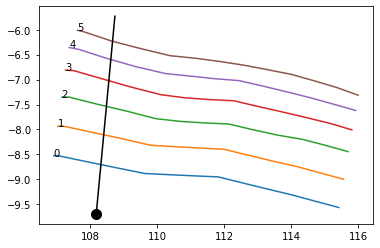

In [17]:
for i in intersecting_lines[intersecting_cross_sections_index[test_index]]:
#    print(i[1])
    plt.plot(i[1].to_lat_lon_array()[:,1],
             i[1].to_lat_lon_array()[:,0])
    plt.text(i[1].to_lat_lon_array()[:,1][0],
             i[1].to_lat_lon_array()[:,0][0], int(i[0]))
plt.plot(cross_section_lines[intersecting_cross_sections_index[test_index]].to_lat_lon_array()[:,1],
         cross_section_lines[intersecting_cross_sections_index[test_index]].to_lat_lon_array()[:,0], c='k')
plt.scatter(cross_section_lines[intersecting_cross_sections_index[test_index]].to_lat_lon_array()[:,1][0],
            cross_section_lines[intersecting_cross_sections_index[test_index]].to_lat_lon_array()[:,0][0], c='k', s=100)
#plt.ylim(10,12)
#plt.xlim(122,122.5)

In [18]:
#test_index = 114
test_lat = []
test_lon = []
for i in intersecting_points[test_index]:
    test_lon.append(i[1].to_lat_lon_array()[0][1])
    test_lat.append(i[1].to_lat_lon_array()[0][0])

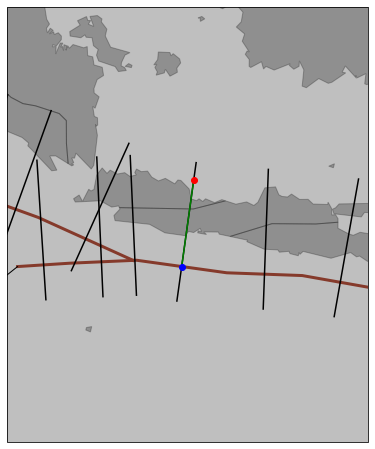

In [19]:
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(16, 8),
                     subplot_kw={'projection': ccrs.Orthographic(np.mean(test_lon),
                                                                 np.mean(test_lat))})
#fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(16, 8),
#                     subplot_kw={'projection': ccrs.Robinson()})

date_line_wrapper = pygplates.DateLineWrapper(0)
data_crs = ccrs.Geodetic()
poly_data_crs = ccrs.PlateCarree()
for i in intersecting_cross_sections_index:
    start_point = cross_section_lines[i].to_lat_lon_array()[0]
    end_point = cross_section_lines[i].to_lat_lon_array()[-1]
    #print(i.to_lat_lon_array()[0], i.to_lat_lon_array()[-1])
    ax.plot([start_point[1], end_point[1]], [start_point[0], end_point[0]],
            c='k',
            zorder=3,
            transform=data_crs)

reconstructed_polygons = []

pygplates.reconstruct(coastlines,rotation_model, reconstructed_polygons, int(time))
for polygon in reconstructed_polygons:
    poly_geom = pygplates.PolygonOnSphere(polygon.get_reconstructed_geometry())
    wrapped_polys = date_line_wrapper.wrap(poly_geom, 1)
    for wrapped_poly in wrapped_polys:
        wrapped_poly_lat = []
        wrapped_poly_lon = []
        for wrapped_poly_point in wrapped_poly.get_exterior_points():
            wrapped_poly_lat.append(wrapped_poly_point.get_latitude())
            wrapped_poly_lon.append(wrapped_poly_point.get_longitude())

        ax.fill(wrapped_poly_lon, wrapped_poly_lat, color='k', alpha=0.25,
                linewidth=1 ,zorder=1, transform=poly_data_crs)

for shared_boundary_section in shared_boundary_sections:
    if shared_boundary_section.get_feature().get_feature_type() == pygplates.FeatureType.gpml_mid_ocean_ridge:
        for shared_sub_segment in shared_boundary_section.get_shared_sub_segments():
            tmp = shared_sub_segment.get_resolved_geometry()
            wrapped_polylines = date_line_wrapper.wrap(tmp)
            for wrapped_polyline in wrapped_polylines:
                mor_wrapped_point_lat = []
                mor_wrapped_point_lon = []
                for wrapped_point in wrapped_polyline.get_points():
                    mor_wrapped_point_lat.append(wrapped_point.get_latitude())
                    mor_wrapped_point_lon.append(wrapped_point.get_longitude())
                ax.plot(mor_wrapped_point_lon,mor_wrapped_point_lat, color='#545eb3',
                        linewidth=3, alpha=1, zorder=2, transform=data_crs)

    elif shared_boundary_section.get_feature().get_feature_type() == pygplates.FeatureType.gpml_subduction_zone:
        for shared_sub_segment in shared_boundary_section.get_shared_sub_segments():
            tmp = shared_sub_segment.get_resolved_geometry()
            wrapped_polylines = date_line_wrapper.wrap(tmp)
            for wrapped_polyline in wrapped_polylines:
                mor_wrapped_point_lat = []
                mor_wrapped_point_lon = []
                for wrapped_point in wrapped_polyline.get_points():
                    mor_wrapped_point_lat.append(wrapped_point.get_latitude())
                    mor_wrapped_point_lon.append(wrapped_point.get_longitude())
                ax.plot(mor_wrapped_point_lon,mor_wrapped_point_lat, color='#853a2b',
                        linewidth=3, alpha=1, zorder=2, transform=data_crs)                
    else:
        for shared_sub_segment in shared_boundary_section.get_shared_sub_segments():
            tmp = shared_sub_segment.get_resolved_geometry()
            wrapped_polylines = date_line_wrapper.wrap(tmp)
            for wrapped_polyline in wrapped_polylines:
                mor_wrapped_point_lat = []
                mor_wrapped_point_lon = []
                for wrapped_point in wrapped_polyline.get_points():
                    mor_wrapped_point_lat.append(wrapped_point.get_latitude())
                    mor_wrapped_point_lon.append(wrapped_point.get_longitude())
                ax.plot(mor_wrapped_point_lon,mor_wrapped_point_lat, color='k',
                        linewidth=1, alpha=1, zorder=2, transform=data_crs)

gl = ax.gridlines()
gl.xlocator = mticker.FixedLocator([-180, -120, -60, 0, 60, 120, 180])
gl.ylocator = mticker.FixedLocator([-90, -60, -30, 0, 30, 60, 90])
#ax.scatter(134, 31, c='green', s=100,transform=poly_data_crs, zorder=4)
ax.plot(test_lon, test_lat, c='green',transform=data_crs, zorder=4)
#extent=[longitude_top_left,longitude_top_right,latitude_bottom_left,latitude_top_left].
ax.set_extent([np.min(test_lon)-5, np.max(test_lon)+5, np.min(test_lat)-5, np.max(test_lat)+5],
              crs=ccrs.PlateCarree())
ax.scatter(test_lon[0], test_lat[0], c='blue', transform=poly_data_crs, zorder=5)
ax.scatter(test_lon[-1], test_lat[-1], c='red', transform=poly_data_crs, zorder=5)
#ax.set_global()
#fig.savefig('/Users/andrew/Documents/Manuscripts/Merdith_2021_serpentinite_sub_zones/cross_sections.pdf')

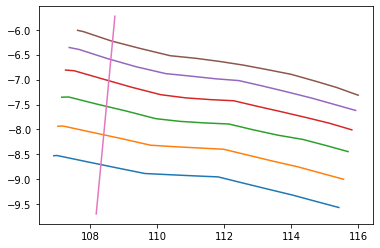

In [20]:
for i in intersecting_lines[intersecting_cross_sections_index[test_index]]:
#    print(i[1])
    plt.plot(i[1].to_lat_lon_array()[:,1],
             i[1].to_lat_lon_array()[:,0])
    
plt.plot(cross_section_lines[intersecting_cross_sections_index[test_index]].to_lat_lon_array()[:,1],
         cross_section_lines[intersecting_cross_sections_index[test_index]].to_lat_lon_array()[:,0])

In [21]:
colors = ['green', 'red', 'blue', 'orange', 'brown', 'purple']

0.0 green
1.0 red
2.0 blue
3.0 orange
4.0 brown
5.0 purple


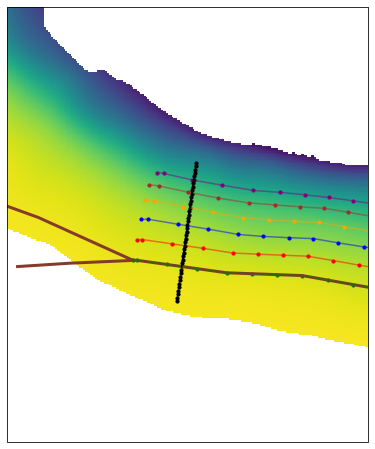

In [22]:
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(16, 8),
                     subplot_kw={'projection': ccrs.Orthographic(np.mean(test_lon),
                                                                 np.mean(test_lat))})
data_crs = ccrs.Geodetic()
poly_data_crs = ccrs.PlateCarree()
for shared_boundary_section in shared_boundary_sections:
    if shared_boundary_section.get_feature().get_feature_type() == pygplates.FeatureType.gpml_subduction_zone:
        for shared_sub_segment in shared_boundary_section.get_shared_sub_segments():
            tmp = shared_sub_segment.get_resolved_geometry()
            wrapped_polylines = date_line_wrapper.wrap(tmp)
            for wrapped_polyline in wrapped_polylines:
                mor_wrapped_point_lat = []
                mor_wrapped_point_lon = []
                for wrapped_point in wrapped_polyline.get_points():
                    mor_wrapped_point_lat.append(wrapped_point.get_latitude())
                    mor_wrapped_point_lon.append(wrapped_point.get_longitude())
                plt.plot(mor_wrapped_point_lon,mor_wrapped_point_lat, color='#853a2b',
                        linewidth=3, alpha=1, zorder=2, transform=data_crs)
                
for i in intersecting_lines[intersecting_cross_sections_index[test_index]]:
    print(i[0], colors[int(i[0])])
#    print(i[1])
    ax.scatter(i[1].to_lat_lon_array()[:,1],
                i[1].to_lat_lon_array()[:,0],
                c=colors[int(i[0])],
               s=10, transform=poly_data_crs)
    ax.plot(i[1].to_lat_lon_array()[:,1],
             i[1].to_lat_lon_array()[:,0],
            c=colors[int(i[0])], alpha=0.5, transform=poly_data_crs)
    
ax.plot(cross_section_lines[intersecting_cross_sections_index[test_index]].to_lat_lon_array()[:,1],
         cross_section_lines[intersecting_cross_sections_index[test_index]].to_lat_lon_array()[:,0],
            c='k', alpha=0.5, transform=poly_data_crs)
ax.scatter(cross_section_lines[intersecting_cross_sections_index[test_index]].to_lat_lon_array()[:,1],
            cross_section_lines[intersecting_cross_sections_index[test_index]].to_lat_lon_array()[:,0],
            c='k', s=10, transform=poly_data_crs)
ax.plot(test_lon, test_lat, c='black', zorder=4, transform=data_crs)

# Get min and max values of the subducting plates' depths
vmax = max([grid.depth.actual_range[1] for grid in subduction_zones])
vmin = min([grid.depth.actual_range[0] for grid in subduction_zones])

for grid in subduction_zones:
    #print(grid)
    grid.depth.plot.pcolormesh(
        add_colorbar=False,
        vmin=vmin,
        vmax=vmax,
        zorder=0, transform=poly_data_crs    )

#plt.grid()
ax.set_extent([np.min(test_lon)-5, np.max(test_lon)+5, np.min(test_lat)-5, np.max(test_lat)+5],
              crs=ccrs.PlateCarree())



0.0 green
1.0 red
2.0 blue
3.0 orange
4.0 brown
5.0 purple


(-9.70380197957427, -5.231916884281706)

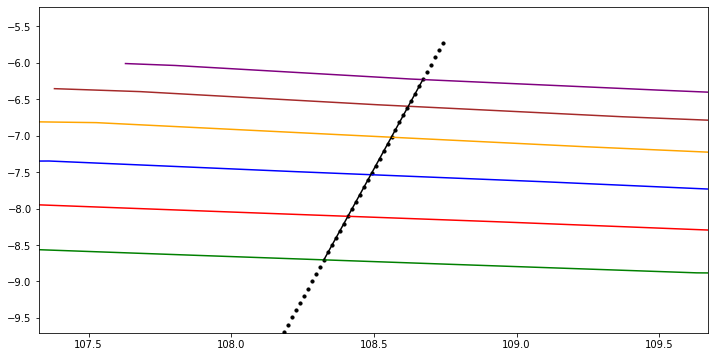

In [23]:
plt.figure(figsize=(12,6))
for i in intersecting_lines[intersecting_cross_sections_index[test_index]]:
    print(i[0], colors[int(i[0])])
#    print(i[1])
    plt.plot(i[1].to_lat_lon_array()[:,1],
                i[1].to_lat_lon_array()[:,0],
                c=colors[int(i[0])])
    
plt.scatter(cross_section_lines[intersecting_cross_sections_index[test_index]].to_lat_lon_array()[:,1],
            cross_section_lines[intersecting_cross_sections_index[test_index]].to_lat_lon_array()[:,0],
            c='k', s=10)
plt.plot(test_lon, test_lat, c='k', zorder=4)
plt.xlim(np.min(test_lon)-1, np.max(test_lon)+1)
plt.ylim(np.min(test_lat)-1, np.max(test_lat)+1)

In [24]:
#get distances between points
distance_range, cum_distances, incremental_distances = slab_workflow.get_distances(intersecting_points,
                                                                     intersecting_depths,
                                                                     tracks)

for ind, track_path in enumerate(tracks):
    track_path['cum_distance'] = distance_range[ind]

In [25]:
# Options for Model are:
#  - D80
#  - X25
#  - W1300
#  - T550
MODEL = 'T550'

SlabDir = '%ssyracuse_thermal/Syracuse++_supp_Material/models/%s' % (datadir, MODEL)

files=[]
for(dirpath,dirnames,filenames) in walk(SlabDir):
    files.extend(filenames)
    break
files.sort()
#print f
arcs = []
for file in files:
    arcs.append(file.split('.')[0])
    
#slab surface | moho surface | slab curie depth | magnetite depth | moho curie depth
surface_arrays = []
isotherm_arrays = []
for j in np.arange(len(files)):

        FNAME = files[j]

        tmp_surface_arrays, tmp_isotherm_arrays = slab_workflow.get_slab_surfaces(SlabDir, FNAME)
        surface_arrays.append(tmp_surface_arrays)
        isotherm_arrays.append(tmp_isotherm_arrays)
        
#NB results are:
#surface (0 for top of slab, 7 for moho) | horiontal distance from trench | depth | temperature

In [26]:
#load csv data of syracuse
df_syracuse = pd.read_csv('%ssyracuse_thermal/Table_2_sub_parameters.csv' % datadir)

closest_indices = []
closest_sub = []
thermal_data = []
for index in intersecting_cross_sections_index:
    #print(index)
    input_lat = cross_section_start_points[index][0]
    input_lon = cross_section_start_points[index][1]
    
    #lol gotta take it back out
    if input_lon > 180:
        input_lon = input_lon-360
    #print(index, input_lat, input_lon)
    #get closest based on lat
    df_sort = df_syracuse.iloc[(df_syracuse['Lat']-int(input_lat)).abs().argsort()[:10]]
    #now cross check for long
    df_closest = df_sort.iloc[(df_sort['Lon']-int(input_lon)).abs().argsort()[:1]]
    #print(df_closest['Name'])
    #to get index
    closest_index = df_closest.index.tolist()
    
    #index of closest will correspond to our slab surface database index
    index_of_closest = slab_workflow.find_with_list(arcs, df_closest['Name'].values[0])
    thermal_data_of_closest = surface_arrays[index_of_closest[0]]


    closest_indices.append(closest_index[0])
    closest_sub.append(df_closest)
    thermal_data.append(thermal_data_of_closest)

In [27]:
#here we map peridotite concentrations from our slab warping using the corrected depths
#to cross section depth from Slab2.0 (as the indices of interpolated depth and peridotite are the same)
#peridotite_content = []
#pressure = []
empty_index = []
for ind, track_path in enumerate(tracks):
    print(ind)
    #we want to use the depths from the slab 2.0 geometry as our 'base model'
    base_cross_section_cum_dist = np.asarray(track_path['cum_distance'])#thermal_data_of_cross_section[0][::,2]
    base_cross_section_depths = np.asarray(track_path['depth'])#thermal_data_of_cross_section[0][::,2]

    #get pressure
    local_pressure = []
    for X_depth in base_cross_section_depths:
        #pressure in GPa
        local_pressure.append(X_depth*9.8*3.3*1000*1000*1e-6*1e-3)
    #pressure.append(local_pressure)
    local_pressure = np.asarray(local_pressure)
    #interpolated depths to match to base cross section depth
    #tmp_intersecting_depths = np.asarray(intersecting_depths[ind])
    tmp_intersecting_cum_distance = np.asarray(cum_distances[ind])
    if len(tmp_intersecting_cum_distance) <= 1:
        empty_index.append(ind)
        continue
        ##get nearest indices
    vec_nearest = lambda x: slab_workflow._find_nearest(tmp_intersecting_cum_distance, x)
    index_of_nearest_dist = np.vectorize(vec_nearest)(base_cross_section_cum_dist)
#
    ##find peridotite values at index
    perid_at_depth = []
    age_at_depth = []
    sub_iso_chron_at_depth = []
    #print(index_of_nearest_dist)
    for ind2,i in enumerate(index_of_nearest_dist):
        #print(ind, perid_variable[ind])
        perid_at_depth.append(perid_variable[ind][i])
        age_at_depth.append(age_variable[ind][i])
        sub_iso_chron_at_depth.append(intersecting_points[ind][i][0])

    perid_at_depth = np.asarray(perid_at_depth)
    age_at_depth = np.asarray(age_at_depth)
    sub_iso_chron_at_depth = np.asarray(sub_iso_chron_at_depth)
    #now for thermal data, [1] for slab moho, [0] for slab surface
    syracuse_depths = thermal_data[ind][1][::,2]
    syracuse_temps = thermal_data[ind][1][::,3]

    #get nearest indices
    vec_nearest_SYR = lambda x: slab_workflow._find_nearest_temp(syracuse_depths, x)
    index_of_nearest_depth_SYR = np.vectorize(vec_nearest_SYR)(base_cross_section_depths)
    #print(index_of_nearest_depth)
    temp_at_depth = []
    for ind3,i in enumerate(index_of_nearest_depth_SYR):
        if i == len(syracuse_depths):
            temperature = syracuse_temps[i-1]
        #print(i)
        else:
            temperature = syracuse_temps[i]

        temp_at_depth.append(temperature)
    temp_at_depth = np.asarray(temp_at_depth)
    
    #add to our dataframe
    #track_path['cum_distance'] = distance_range[ind]
    #print(local_pressure)
    track_path['pressure'] = local_pressure
    track_path['temp'] = temp_at_depth    
    track_path['peridotite'] = perid_at_depth
    track_path['age'] = age_at_depth
    track_path['sub_zone'] = closest_sub[ind]['Name'].values[0]
    track_path['sub_time'] = sub_iso_chron_at_depth[::-1]
    #print(track_path)

0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
201
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216
217
218
219
220
221
222
223
224
225
226
227
228
229
230
231
232
233
234
235
236
237
238
239
240
241
242
243
244
245
246
247
248
249
250
251
252
253
254
255
256
257
258
259
260
261
262
263
264
265
266
267
268
269
270
271
272
273
274
275
276
27

In [28]:
#here we map peridotite concentrations from our slab warping using the corrected depths
#to cross section depth from Slab2.0 (as the indices of interpolated depth and peridotite are the same)
#peridotite_content = []
#pressure = []
empty_index = []
for ind, track_path in enumerate(tracks):
    print(ind)
    #we want to use the depths from the slab 2.0 geometry as our 'base model'
    base_cross_section_cum_dist = np.asarray(track_path['cum_distance'])#thermal_data_of_cross_section[0][::,2]
    base_cross_section_depths = np.asarray(track_path['depth'])#thermal_data_of_cross_section[0][::,2]

    #interpolated depths to match to base cross section depth
    tmp_intersecting_depths = np.asarray(intersecting_depths[ind])
    #tmp_intersecting_cum_distance = np.asarray(cum_distances[ind])
    if len(tmp_intersecting_depths) <= 1:
        empty_index.append(ind)
        continue
        ##get nearest indices
    vec_nearest = lambda x: slab_workflow._find_nearest(tmp_intersecting_depths, x)
    index_of_nearest_depth = np.vectorize(vec_nearest)(base_cross_section_depths)
#
    ##find peridotite values at index
    perid_at_depth = []
    age_at_depth = []
    sub_iso_chron_at_depth = []
    #print(index_of_nearest_dist)
    for ind2,i in enumerate(index_of_nearest_depth):
        #print(ind, perid_variable[ind])
        perid_at_depth.append(perid_variable[ind][i])
        age_at_depth.append(age_variable[ind][i])
        sub_iso_chron_at_depth.append(intersecting_points[ind][i][0])

    perid_at_depth = np.asarray(perid_at_depth)
    age_at_depth = np.asarray(age_at_depth)
    sub_iso_chron_at_depth = np.asarray(sub_iso_chron_at_depth)


    #add to our dataframe
    #track_path['cum_distance'] = distance_range[ind]
    track_path['peridotite_depth'] = perid_at_depth
    track_path['age_depth'] = age_at_depth


0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
201
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216
217
218
219
220
221
222
223
224
225
226
227
228
229
230
231
232
233
234
235
236
237
238
239
240
241
242
243
244
245
246
247
248
249
250
251
252
253
254
255
256
257
258
259
260
261
262
263
264
265
266
267
268
269
270
271
272
273
274
275
276
27

In [29]:
perid_diff = []
age_diff = []
perid_std = []
age_std = []
ind4 = []
for ind, i in enumerate(tracks):
    #print(i)
    if np.shape(i)[1] == 5:
        print('here', ind)
        continue
    perid_diff.append(np.mean(np.abs(i['peridotite']-i['peridotite_depth'])))
    age_diff.append(np.mean(np.abs(i['age']-i['age_depth'])))
    perid_std.append(np.std(np.abs(i['peridotite']-i['peridotite_depth'])))
    age_std.append(np.std(np.abs(i['age']-i['age_depth'])))
    ind4.append(ind)

here 6
here 30
here 88
here 89
here 95
here 117
here 148
here 217
here 381


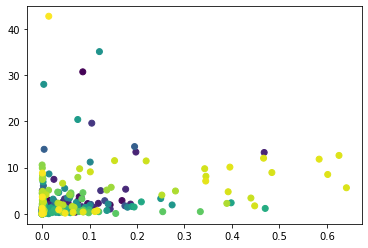

In [30]:
plt.scatter(perid_diff, age_diff, c=np.asarray(ind4))

Text(0.5, 0, 'RAP differece')

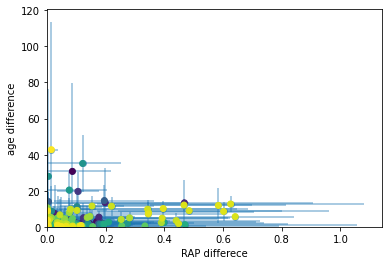

In [31]:
plt.errorbar(perid_diff, age_diff, xerr=perid_std, yerr=age_std, fmt='o', zorder=1, alpha=0.5)
plt.scatter(perid_diff, age_diff, c=np.asarray(ind4), zorder=2)
plt.ylim(0)
plt.xlim(0)
plt.ylabel('age difference')
plt.xlabel('RAP differece')

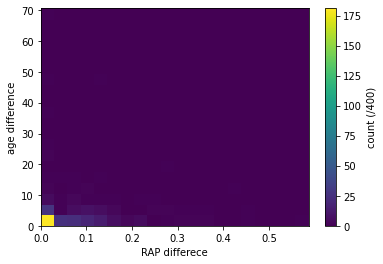

In [32]:
plt.hist2d(perid_std, age_std, (20,20))
plt.ylabel('age difference')
plt.xlabel('RAP differece')
plt.colorbar(label='count (/400)')

In [33]:
for ind,i in enumerate(tracks):
    if np.shape(i)[1] == 5:
        print('here', ind)
        continue
    print(ind, i['sub_zone'].values[0])

0 Bali_Lombok
1 W_Banda_Sea
2 W_Banda_Sea
3 W_Banda_Sea
4 E_Banda_Sea
5 E_Banda_Sea
here 6
7 E_Banda_Sea
8 E_Banda_Sea
9 E_Banda_Sea
10 Sunda_Strait
11 Sunda_Strait
12 Sunda_Strait
13 Sunda_Strait
14 Java
15 Java
16 Java
17 Alaska
18 Alaska
19 Alaska
20 Alaska
21 Alaska
22 Alaska
23 Alaska
24 Alaska_Peninsula
25 Alaska_Peninsula
26 Alaska_Peninsula
27 E_Aleut
28 C_Aleut
29 C_Aleut
here 30
31 Kamchatka
32 Kamchatka
33 Kamchatka
34 Kamchatka
35 Kamchatka
36 N_Vanuatu
37 N_Vanuatu
38 N_Vanuatu
39 N_Vanuatu
40 N_Vanuatu
41 N_Vanuatu
42 N_Vanuatu
43 S_Vanuatu
44 S_Vanuatu
45 N_Phil
46 N_Phil
47 N_Phil
48 N_Phil
49 Ryukyu
50 Ryukyu
51 Ryukyu
52 Kyushu
53 Kyushu
54 Kyushu
55 Kyushu
56 Kyushu
57 N_Vanuatu
58 Solomon
59 Solomon
60 Solomon
61 Solomon
62 Solomon
63 Solomon
64 Solomon
65 Solomon
66 Tonga
67 Tonga
68 Tonga
69 Tonga
70 Tonga
71 Tonga
72 Tonga
73 Tonga
74 Tonga
75 Tonga
76 Tonga
77 Tonga
78 Tonga
79 E_Banda_Sea
80 E_Banda_Sea
81 S_Phil
82 S_Phil
83 S_Phil
84 S_Phil
85 S_Phil
86 S_Phi

In [34]:
tracks[89]

,lon,lat,depth,depth_uncertainty,cum_distance
51,260.366050,16.221995,7.318318,7.770204,0.000000
52,260.374180,16.240534,7.449581,7.897163,2.236709
53,260.382310,16.259073,7.642325,8.081873,4.473419
54,260.390440,16.277612,7.894457,8.314071,6.710128
55,260.398570,16.296151,8.160765,8.542088,8.946838
...,...,...,...,...,...
195,261.536781,18.891585,92.886266,15.089351,322.086157
196,261.544911,18.910124,95.900921,14.919393,324.322866
197,261.553041,18.928663,99.004527,14.735560,326.559576
198,261.561171,18.947202,102.193655,14.540447,328.796285


In [35]:
test = intersecting_lines[intersecting_cross_sections_index[test_index]]

In [ ]:
intersecting_lines[intersecting_cross_sections_index[test_index]][0]

In [ ]:
#define line for cross section
#we need two types of cross sections, one for slab 2.0
#one for pygmt
#they, unfortunately, have to be built in different ways

#slab2.0
lat1 = key[0]
lon1 = key[2]
lat2 = key[1]
lon2 = key[3]
cross_section_line = slab_workflow.cross_section_line_pygplates(lat1,lon1,lat2,lon2,0.1)

#get the iso-subchrons that intersect the cross section line

intersecting_lines = []
for ind, polyline in enumerate(output_data):
    
    #get min distance between 'iso-sub-chron' and our cross section
    min_distance_to_feature = pygplates.GeometryOnSphere.distance(polyline[1],cross_section_line)
    #if min distance is 0, then they intersect and we want the rest of the data
    if min_distance_to_feature == 0:
        intersecting_lines.append(polyline)
        

steps = 200
lat = np.linspace(lat1,lat2, int(steps))
lon = np.linspace(lon1,lon2, int(steps))
#pygmt track needs lon/lat as separate columns in pandas dataframe
d = { 'lon': lon,'lat': lat}
points = pd.DataFrame(data=d)



In [ ]:
###main calculation, get data from cross sections

# Sample the sub zone using grdtrack. It returns a dataframe with a new column and the results
track = pygmt.grdtrack(points=points, grid=grid, newcolname='depth')
track_uncertain = pygmt.grdtrack(points=points, grid=grid_uncertainty, newcolname='depth_uncertainty')
#the df will contain some NaNs that we want to filter
track_dropna = track.dropna()
track_uncertain_dropna = track_uncertain.dropna()
#our data so far
track_dropna['depth'] = track_dropna['depth'] * -0.001

track_uncertain_dropna['depth_uncertainty'] = track_uncertain_dropna['depth_uncertainty'] * 0.001
#get points intersecting the cross section from slab 2.0
intersecting_points_reversed, intersecting_points, interpolated_variables, interpolated_depths = get_intersecting_values(intersecting_lines, cross_section_line)

In [ ]:
interpolated_variables

In [ ]:
intersecting_points_reversed[0][1].to_lat_lon_array()

In [ ]:
intersecting_points

In [ ]:
#pressure tests

In [ ]:
#assume 30 km for continental crust?
density = np.ones_like(depth)
continental_curst_rho = 2.83
mantle_rho = 3.3

for ind,i in enumerate(depth):
    if i <=30:
        density[ind] = continental_curst_rho
    else:
        density[ind] = mantle_rho
        

In [ ]:
def calcualte_pressure(density, depth):
    
    '''
    Calculate pressure at a series of points of set depths (km) with designated densities (g/cm3). Assumes 
    gravity is constant (9.8 m/s**2).

    The basic equation we use is:

    pressure = density • gravity • depth (with depth being total depth, or thickness of the layer)


    Parameters
    -----------
    Density: list or array of densities, in g/cm3.
        The collection of densities. Must correspond to each depth.

    Depth: list or array of depths, in km
        The collection of depths (from surface). Must have a corresponding density for each depth.

    Returns
    -------
    Pressure: array of cumulative pressure, in Megapascals.
        The cumulative pressure at each depth point.
    '''
    #set gravity
    g = 9.8
    
    #check if density is a list, if so convert to array
    if isinstance(density, list): 
        density = np.asarray(density)
        
    #check if depth is a list, if so convert to array
    if isinstance(depth, list): 
        depth = np.asarray(depth)

    #convert density to kg/m3
    rho = density * 1000

    #conver density to m
    Z_bot = depth * 1000
    
    #get incremental depths
    layer_thicknesses = np.zeros_like(depth)
    for ind,i in enumerate(Z_bot):
        #we just use the current depth and subtract the previous one from it
        if ind == 0:
            #for the first point we just need index 0
            layer_thicknesses[ind] = Z_bot[ind]
        else:
            #subtract current depth from previous one to get the change (i.e. the thickness of each layer)
            layer_thicknesses[ind] = (Z_bot[ind] - Z_bot[ind-1])

    #we sum the layer thicknesses and corresponding densities, and multiply by gravity to get pressure in pascals
    pressure = np.sum(layer_thicknesses * rho) * g
    #in megapascals
    pressure = pressure * 1e-6

    return pressure

In [ ]:
# Determine the overriding and subducting plates of the subduction shared sub-segment.
def find_overriding_and_subducting_plates(subduction_shared_sub_segment, time):

    # Get the subduction polarity of the nearest subducting line.
    subduction_polarity = subduction_shared_sub_segment.get_feature().get_enumeration(pygplates.PropertyName.gpml_subduction_polarity)
    if (not subduction_polarity) or (subduction_polarity == 'Unknown'):
        print('Unable to find the overriding plate of the subducting shared sub-segment "{0}"'.format(
            subduction_shared_sub_segment.get_feature().get_name()), file=sys.stderr)
        print('    subduction zone feature is missing subduction polarity property or it is set to "Unknown".', file=sys.stderr)
        return

    # There should be two sharing topologies - one is the overriding plate and the other the subducting plate.
    sharing_resolved_topologies = subduction_shared_sub_segment.get_sharing_resolved_topologies()
    if len(sharing_resolved_topologies) != 2:
        print('Unable to find the overriding and subducting plates of the subducting shared sub-segment "{0}" at {1}Ma'.format(
            subduction_shared_sub_segment.get_feature().get_name(), time), file=sys.stderr)
        print('    there are not exactly 2 topologies sharing the sub-segment.', file=sys.stderr)
        print(str(sharing_resolved_topologies[0].get_resolved_feature().get_reconstruction_plate_id()), file=sys.stderr)
        return

    overriding_plate = None
    subducting_plate = None

    geometry_reversal_flags = subduction_shared_sub_segment.get_sharing_resolved_topology_geometry_reversal_flags()
    for index in range(2):

        sharing_resolved_topology = sharing_resolved_topologies[index]
        geometry_reversal_flag = geometry_reversal_flags[index]

        if sharing_resolved_topology.get_resolved_boundary().get_orientation() == pygplates.PolygonOnSphere.Orientation.clockwise:
            # The current topology sharing the subducting line has clockwise orientation (when viewed from above the Earth).
            # If the overriding plate is to the 'left' of the subducting line (when following its vertices in order) and
            # the subducting line is reversed when contributing to the topology then that topology is the overriding plate.
            # A similar test applies to the 'right' but with the subducting line not reversed in the topology.
            if ((subduction_polarity == 'Left' and geometry_reversal_flag) or
                (subduction_polarity == 'Right' and not geometry_reversal_flag)):
                overriding_plate = sharing_resolved_topology
            else:
                subducting_plate = sharing_resolved_topology
        else:
            # The current topology sharing the subducting line has counter-clockwise orientation (when viewed from above the Earth).
            # If the overriding plate is to the 'left' of the subducting line (when following its vertices in order) and
            # the subducting line is not reversed when contributing to the topology then that topology is the overriding plate.
            # A similar test applies to the 'right' but with the subducting line reversed in the topology.
            if ((subduction_polarity == 'Left' and not geometry_reversal_flag) or
                (subduction_polarity == 'Right' and geometry_reversal_flag)):
                overriding_plate = sharing_resolved_topology
            else:
                subducting_plate = sharing_resolved_topology

    if overriding_plate is None:
        print('Unable to find the overriding plate of the subducting shared sub-segment "{0}" at {1}Ma'.format(
            subduction_shared_sub_segment.get_feature().get_name(), time), file=sys.stderr)
        print('    both sharing topologies are on subducting side of subducting line.', file=sys.stderr)
        return

    if subducting_plate is None:
        print('Unable to find the subducting plate of the subducting shared sub-segment "{0}" at {1}Ma'.format(
            subduction_shared_sub_segment.get_feature().get_name(), time), file=sys.stderr)
        print('    both sharing topologies are on overriding side of subducting line.', file=sys.stderr)
        return

    return (overriding_plate, subducting_plate, subduction_polarity)

In [ ]:
pressure = np.ones_like(density)

for ind, i in enumerate(pressure):
    #if we are at the max length then we need all values
    if ind == len(depth) - 1:
        pressure[ind] = calcualte_pressure(density, depth)
    else:
        pressure[ind] = calcualte_pressure(density[:ind+1], depth[:ind+1])
    
    

In [ ]:
plt.plot(pressure*1e-3, depth)
plt.ylim(200,0)
#plt.xlim(0,10000)

In [ ]:
index_to_remove = []
for index, i in enumerate(intersecting_lines[intersecting_cross_sections_index[test_index]]):
    a = cross_section_lines[intersecting_cross_sections_index[test_index]]
    a1 = i[1]

    closest_point_data = \
    pygplates.GeometryOnSphere.distance(a,
                                        a1,
                                        return_closest_positions=True,
                                        return_closest_indices=True)
    a_nearest_segment = closest_point_data[3]
    a1_nearest_segment = closest_point_data[4]

    b = a.get_segments()[a_nearest_segment]
    c = b.get_arc_direction(0.5)

    b1 = a1.get_segments()[a1_nearest_segment]
    c1 = b1.get_arc_direction(0.5)

    deviation_of_segment_direction_from_stage_pole = \
    pygplates.Vector3D.angle_between(c, c1)

    # Change the angle to be between 0 and 90
    deviation_of_segment_direction_from_stage_pole_mod = \
    90-np.abs(90-np.remainder(np.degrees(deviation_of_segment_direction_from_stage_pole),\
                              180))

    print(i[0], deviation_of_segment_direction_from_stage_pole_mod)
    if deviation_of_segment_direction_from_stage_pole_mod < 60.0:
        index_to_remove.append(index)

In [ ]:
###now it is time for figuring out a global estimate

In [ ]:
rotation_filename = '/Users/Andrew/Documents/EarthByte_Models/Muller++_2015_AREPS_CORRECTED/Global_EarthByte_230-0Ma_GK07_AREPS.rot'

input_topology_filename = ['/Users/Andrew/Documents/EarthByte_Models/Muller++_2015_AREPS_CORRECTED/Global_EarthByte_230-0Ma_GK07_AREPS_PlateBoundaries.gpml',
                           '/Users/Andrew/Documents/EarthByte_Models/Muller++_2015_AREPS_CORRECTED/Global_EarthByte_230-0Ma_GK07_AREPS_Topology_BuildingBlocks.gpml']

coastline_polygons = '/Applications/GPlates-2.2.0/SampleData/FeatureCollections/Coastlines/Matthews_etal_GPC_2016_Coastlines.gpmlz'
isochrons = '/Applications/GPlates-2.2.0/SampleData/FeatureCollections/Isochrons/Muller_etal_AREPS_2016_Isochrons.gpmlz'
COBs = '/Users/Andrew/Documents/PhD/Scripts/Python_Scripts/pyGPlates_examples/Merdith_2019_Frontiers/Sample_Data/Global_EarthByte_GeeK07_COB_Terranes_Matthews_etal.gpml'
#topology_features = pygplates.FeatureCollection(input_topology_filename)
rotation_model = pygplates.RotationModel(rotation_filename)


In [ ]:
time = 0 
# Alternative method using 'partition_geometry'
resolved_topologies = []
shared_boundary_sections = []

pygplates.resolve_topologies(input_topology_filename, rotation_model,
                             resolved_topologies, int(time), shared_boundary_sections)


In [ ]:
cross_section_points = []
sub_length = []
polarity = []
segments = []
for shared_boundary_section in shared_boundary_sections:
    if shared_boundary_section.get_feature().get_feature_type() == pygplates.FeatureType.gpml_subduction_zone:
        for shared_sub_segment in shared_boundary_section.get_shared_sub_segments():
            tmp_polarity = find_overriding_and_subducting_plates(shared_sub_segment, 0)
            #print (tmp_polarity)
            if tmp_polarity is None:
                continue
            
            for segment in shared_sub_segment.get_geometry().get_segments():
                #print(segment.get_start_point().to_lat_lon())
                #print(segment.get_start_point().to_lat_lon()[0])
                #print(segment.get_start_point().to_lat_lon()[1])
                segment_mean_lat = np.mean((segment.get_start_point().to_lat_lon()[0],
                                            segment.get_end_point().to_lat_lon()[0]))
                segment_mean_lon = np.mean((segment.get_start_point().to_lat_lon()[1],
                                            segment.get_end_point().to_lat_lon()[1]))

                cross_section_points.append([segment_mean_lat, segment_mean_lon])
                segments.append(segment)
                sub_length.append(segment.get_arc_length()*pygplates.Earth.mean_radius_in_kms)
                polarity.append(tmp_polarity[2])#tessellate
cross_section_points = np.asarray(cross_section_points)
sub_length = np.asarray(sub_length)

In [ ]:
plt.scatter(cross_section_points[:,1], cross_section_points[:,0])

In [ ]:
polarity

In [ ]:
len(polarity)

In [ ]:
#angular distance we want to sample our cross section
angular_distance = np.radians(5)

for index in range(len(cross_section_points)):

    #mid point of cross section segment
    mid_point = pygplates.PointOnSphere(cross_section_points[ind])
    
    #get normal great circle to segment
    normal = segments[index].get_great_circle_normal().to_normalised()
    
    # Get the unnormalised vector along the normal from the mid point
    stage_pole_x, stage_pole_y, stage_pole_z = pygplates.Vector3D.cross(
                                mid_point.to_xyz(), normal).to_xyz()

    #turn vector into a stage pole? i.e. a point on the great cricle
    stage_pole = pygplates.PointOnSphere(
                        stage_pole_x, stage_pole_y, stage_pole_z, normalise=True)

    #normal great circle always to the left of the 
    if polarity[index] == 'Left':
        subducting_normal_reversal = 1
    else:
        subducting_normal_reversal = -1
    #get the rotation of the stage pole using a set angle
    stage_rotation_positive = pygplates.FiniteRotation(stage_pole, angular_distance * subducting_normal_reversal)


In [ ]:
stage_rotation_positive

In [ ]:
new_point = stage_rotation * point

new_point.to_lat_lon_array()

In [ ]:
segment.get_end_point().to_lat_lon_array()

In [ ]:
plt.figure(figsize=(2.5,3))
           
plt.scatter(segment.get_start_point().to_lat_lon_array()[0][1],
            segment.get_start_point().to_lat_lon_array()[0][0])

plt.scatter(segment.get_end_point().to_lat_lon_array()[0][1],
            segment.get_end_point().to_lat_lon_array()[0][0])

plt.plot([segment.get_start_point().to_lat_lon_array()[0][1], segment.get_end_point().to_lat_lon_array()[0][1]],
         [segment.get_start_point().to_lat_lon_array()[0][0], segment.get_end_point().to_lat_lon_array()[0][0]])

plt.scatter(new_point.to_lat_lon_array()[0][1],
            new_point.to_lat_lon_array()[0][0])

In [ ]:
date_line_wrapper = pygplates.DateLineWrapper(0)
for shared_boundary_section in shared_boundary_sections:
    if shared_boundary_section.get_feature().get_feature_type() == pygplates.FeatureType.gpml_subduction_zone:
        for shared_sub_segment in shared_boundary_section.get_shared_sub_segments():
            tmp = shared_sub_segment.get_resolved_geometry()
            wrapped_polylines = date_line_wrapper.wrap(tmp)
            for wrapped_polyline in wrapped_polylines:
                mor_wrapped_point_lat = []
                mor_wrapped_point_lon = []
                for wrapped_point in wrapped_polyline.get_points():
                    mor_wrapped_point_lat.append(wrapped_point.get_latitude())
                    mor_wrapped_point_lon.append(wrapped_point.get_longitude())
                plt.scatter(mor_wrapped_point_lon,mor_wrapped_point_lat, color='#545eb3',
                        linewidth=3, alpha=0.5, zorder=1)

In [1]:
#some densities
perid_density_g_cm3 = 3.3 #g/cm3
perid_density_g_km3 = perid_density_g_cm3 * 100000**3
perid_density_kg_km3 = perid_density_g_km3 * 1e-3

In [2]:
perid_mass_kg = 3.3e12 #kg
#to convert to volume
perid_vol_km3 = perid_mass_kg/perid_density_kg_km3

In [3]:
perid_vol_km3

1.0

In [47]:
H2O = 3.3e12
H2_max_per_kg = 7.3e-5 #raw is 3.65e-2 moles/kg, so convert to mass: 7.3e-2 g per kg, then to kg per kg; 7.3e-5
H2_min_per_kg = 3.0e-6

In [48]:
print(H2_max_per_kg * H2O)
print(H2_min_per_kg * H2O)


240900000.0
9900000.0


In [45]:
H2_max_per_kg*H2O

240900000.0

In [46]:
240900000.0/1000000000

0.2409

In [23]:
3.3e12/300000000.0

11000.0

In [13]:
4e-2

0.04

In [24]:
1.5e-3

0.0015

In [33]:
1000000000*0.3

300000000.0

In [36]:
300000000.0/H2_max_per_kg/1000000000

7.5

In [49]:
2187768244071.1968 #kg of peridotite, assume all becomes serpentinite

2187768244071.1968

In [50]:
2.1877682440711968e12*0.15

328165236610.6795

In [53]:
328165236610.6795*H2_min_per_kg/1000000000

0.0009844957098320386

In [55]:
5500000/220000000*100

2.5